In [1]:
import re
import pandas as pd

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
%matplotlib inline

import vertica_python as vp

from io import StringIO
import csv
import pandas as pd


from tqdm.auto import tqdm

pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None)
pd.options.display.max_rows = 9999
import datetime
from more_itertools import only

import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')
from chart_studio import plotly
import plotly.offline as pyoff
import matplotlib.pyplot as plt
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)

import pandas_profiling
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import f_classif, mutual_info_classif
from sklearn.model_selection import train_test_split, GridSearchCV


from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_squared_error, f1_score, accuracy_score, roc_curve, roc_auc_score
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay,mean_absolute_error, mean_squared_error, r2_score

from sklearn.ensemble import RandomForestRegressor # инструмент для создания и обучения модели
from sklearn import metrics # инструменты для оценки точности модели
from sklearn.tree import DecisionTreeRegressor

from sklearn.metrics import brier_score_loss, log_loss, confusion_matrix, plot_confusion_matrix, auc, mean_squared_error, roc_auc_score, roc_curve, accuracy_score, precision_score, recall_score, f1_score,precision_recall_curve,average_precision_score

In [2]:
conn_conf = {'host': '',
 'port': ,
 'user': '',
 'password':  '', ####### password
 'database': '',
 'session_label': 'python',
 'unicode_error': 'string',
 'ssl': False,
 'autocommit': True,
 'user_prepare_statements': False,
 'connection_timeout': 8000}

In [1]:
###были проведены рисерчи по выбору фич и в итоге они были собраны в одной таблице в бд

In [170]:
query_4 = '''''''''
select * from  public.repsys_triggers_system_transport_mvp_ml_actuality
'''''''''
with vp.connect(**conn_conf) as conn:
    df4 = pd.read_sql(query_4, conn)

In [171]:
df4

,event_date,user_id,with_violantion,total_liq,cnt_bad_aviability_reviews,perc_for_good_nakrutki_declined,perc_declined,negative_in_vertical,negative_reviews,liq,abuses,neg_target_chats,perc_untarget_chats,pos_target_chats,neg_target_call,perc_untarget_call,pos_target_call,sample
0,2023-04-04,1.785923e+06,True,0,0,0.0,0.0,0,0,0,0,0,0.00,0,0,0.000,0,1
1,2023-04-04,1.017502e+08,True,0,0,0.0,0.0,0,0,0,0,0,0.00,0,0,0.000,0,1
2,2023-04-04,3.674246e+08,False,40,0,0.0,0.0,0,0,0,0,0,0.00,0,0,0.000,0,1
3,2023-04-04,3.696255e+08,True,0,0,0.0,0.0,0,0,0,0,0,0.00,0,0,0.000,0,1
4,2023-04-04,3.759231e+08,True,0,0,0.0,0.0,0,0,0,0,0,0.00,0,0,0.000,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
309211,2023-05-28,1.196945e+12,None,0,0,0.0,0.0,0,0,0,0,0,0.00,0,0,0.000,0,0
309212,2023-05-28,1.203082e+12,None,94,0,0.0,0.0,0,0,0,0,2,1.00,0,2,0.875,0,0
309213,2023-05-28,1.206945e+12,None,0,0,0.0,0.0,0,0,0,0,1,0.75,0,0,0.000,0,0
309214,2023-05-28,1.207184e+12,None,0,0,0.0,0.0,0,0,0,0,0,0.00,0,0,0.000,0,0


In [243]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208257 entries, 0 to 208256
Data columns (total 18 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   event_date                       208257 non-null  object 
 1   user_id                          208249 non-null  float64
 2   with_violantion                  208257 non-null  bool   
 3   total_liq                        208257 non-null  int64  
 4   cnt_bad_aviability_reviews       208257 non-null  int64  
 5   perc_for_good_nakrutki_declined  208257 non-null  float64
 6   perc_declined                    208257 non-null  float64
 7   negative_in_vertical             208257 non-null  int64  
 8   negative_reviews                 208257 non-null  int64  
 9   liq                              208257 non-null  int64  
 10  abuses                           208257 non-null  int64  
 11  neg_target_chats                 208257 non-null  int64  
 12  pe

In [172]:
#данные только с нарушениями
data = df4[df4.with_violantion==True]

In [173]:
#рассмотрим получше полученные все данные с нарушениями и без через профайлинг
pandas_profiling.ProfileReport(df4)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [174]:
#рассмотрим получше полученные данные с нарушениями через профайлинг
pandas_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [175]:
data1= df4[df4.with_violantion==False]
pandas_profiling.ProfileReport(data1)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [177]:
# в тесте у нас нет значения with_violation, мы его должны предсказать, по этому пока просто заполняем нулями (false)
df4['with_violantion'].fillna(False, inplace=True)

<AxesSubplot:>

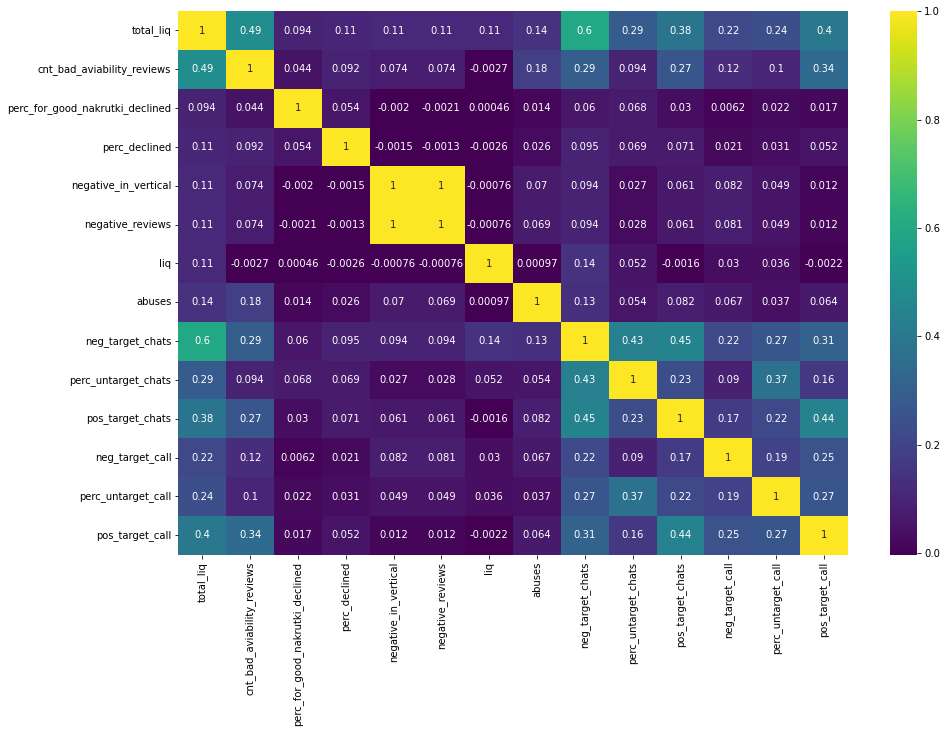

In [178]:
plt.rcParams['figure.figsize'] = (15,10)
sns.heatmap(df4.drop(['user_id', 'sample', 'with_violantion'], axis=1).corr(), cmap = 'viridis',annot = True)

 ##### Построим модель , которая бы классифицировала юзеров на юзеров с нарушением и без с триггерам

##### Построим сначала линейную регрессию и глянем наиболее значимые фичи

In [179]:
# фиксируем RANDOM_SEED, чтобы эксперименты были воспроизводимы
RANDOM_SEED = 42
# зафиксируем версию пакетов, чтобы эксперименты были воспроизводимы
!pip freeze > requirements.txt

In [180]:
#делим наши признаки на котегориальные, бинарные, и числовые (ну в нашем случае только на числовые)
num_cols = ['total_liq', 'cnt_bad_aviability_reviews', 'perc_for_good_nakrutki_declined', 
            'perc_declined', 'negative_in_vertical','negative_reviews',
           'liq','abuses','neg_target_chats', 'perc_untarget_chats',
           'pos_target_chats', 'neg_target_call', 'perc_untarget_call', 'pos_target_call']

In [181]:
# sample = 1 трейн
# sample = 0 текст

In [246]:
# Стандартизация числовых переменных
X_num = StandardScaler().fit_transform(df4[df4['sample'] == 1][num_cols].values)
X_num_test = StandardScaler().fit_transform(df4[df4['sample'] == 0][num_cols].values)

<AxesSubplot:>

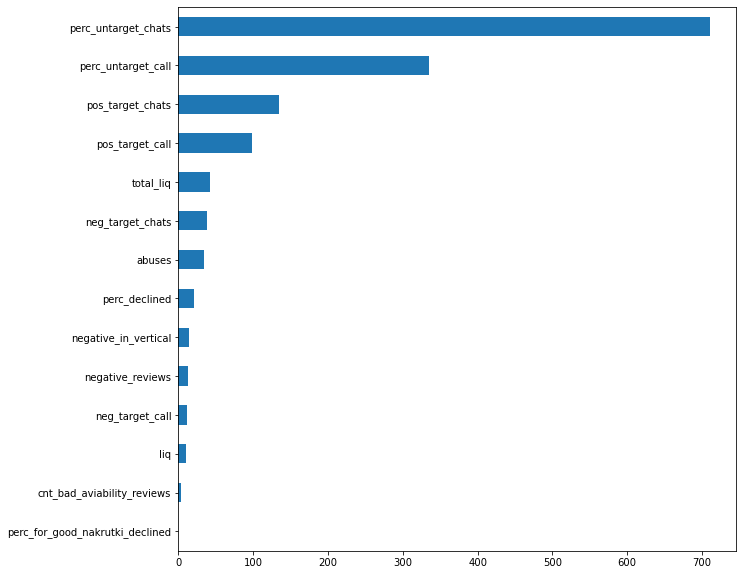

In [249]:
imp_num = pd.Series(f_classif(df4[num_cols], df4['with_violantion'])[0], index = num_cols)
imp_num.sort_values(inplace = True)
imp_num.plot(kind = 'barh')

#### Видим, что наиболее значимые это жалобы, нецелевые чаты и звонки и негативные отзывы. Исходя из выше определенных проблемок с отзывами и жалобами, в модели бралось накопительное кол-во жалоб и отзывов за репутационное окно.

## Создание наивной модели

In [250]:
len(X_test)

15177

In [251]:
X = X_num
Y = df4[df4['sample'] == 1]['with_violantion'].values
X_test = X_num_test
X_train, X_valid, y_train, y_valid = train_test_split(X, Y, test_size=0.20, random_state=42)

In [252]:
X_train.shape, y_train.shape, X_valid.shape, y_valid.shape

((60708, 14), (60708,), (15177, 14), (15177,))

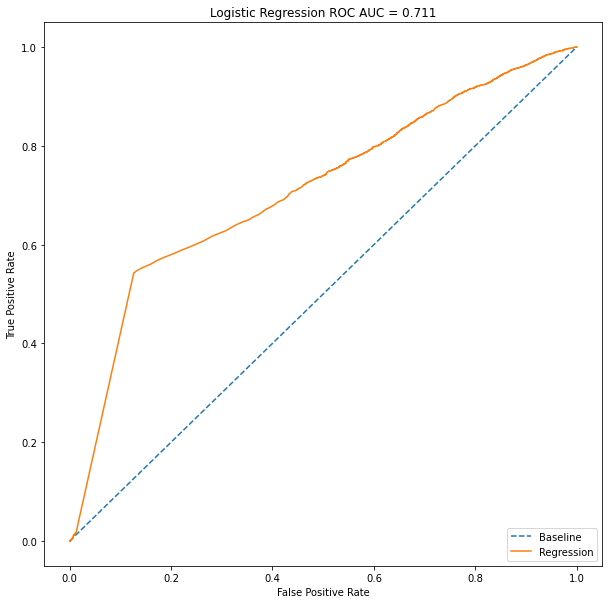

In [253]:
model = LogisticRegression()
model.fit(X_train, y_train)

probs = model.predict_proba(X_valid)
probs = probs[:,1]
y_pred = model.predict(X_valid)
y_pred_prob = model.predict_proba(X_valid)[:,1]

fpr, tpr, threshold = roc_curve(y_valid, probs)
roc_auc = roc_auc_score(y_valid, probs)

plt.figure()
plt.plot([0, 1], label='Baseline', linestyle='--')
plt.plot(fpr, tpr, label = 'Regression')
plt.title('Logistic Regression ROC AUC = %0.3f' % roc_auc)
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc = 'lower right')
plt.show()

In [254]:
print('NAIVE Model\n')
print('accuracy_score:',accuracy_score(y_valid,y_pred))
print('precision_score:',precision_score(y_valid,y_pred))
print('recall_score:',recall_score(y_valid,y_pred))
print('f1_score:',f1_score(y_valid,y_pred))
print ('MAE:', round (mean_absolute_error(y_valid.astype(float),y_pred.astype(float)),3))#Метрики
print ('√MSE:', round (mean_squared_error(y_valid.astype(float),y_pred.astype(float))**(1/2),3))
print ('R2_score:', round (r2_score(y_valid.astype(float),y_pred.astype(float)),3))

NAIVE Model

accuracy_score: 0.7862555182183567
precision_score: 0.7894666666666666
recall_score: 0.9927900737759893
f1_score: 0.8795306001188354
MAE: 0.214
√MSE: 0.462
R2_score: -0.27


[Text(0.5, 0, 'Predicted'), Text(0, 0.5, 'True')]

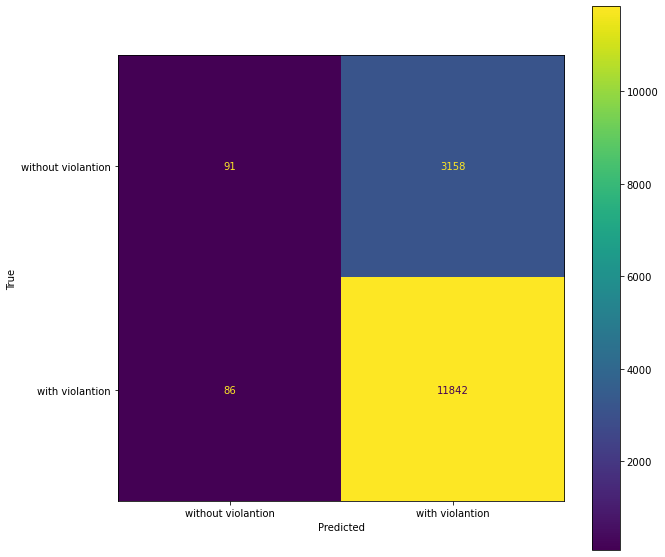

In [255]:
cm = confusion_matrix(y_valid, y_pred)
cmd = ConfusionMatrixDisplay(cm, display_labels=['without violantion','with violantion'])
cmd.plot()
cmd.ax_.set(xlabel='Predicted', ylabel='True')

**Резюме** модель хорошо угадала юзеров с нарушением. Юзеров с нарушением помеченных как без нарушения достаточно мало. Много - 20% пользователей модель отметила как пользователей с нарушением хотя у них нет нарушения. Но для нас ошибка 1-го рода не так страшна для нас, т.к нам важнее не упустить юзеров с нарушением (Т.е мы в ситуации где ошибка 2-го рода для нас дороже чем ошибка 1го рода)

В целом полученные метрики достаточно хорошие, полнота 99%, точность 78%, f1 score 0.87

mean_absolute_error (средняя абсолютная ошибка) всего 0.214,  mean_squared_error (Среднеквадратическое отклонение)  0.462 , r2_score (коэффициент детерминации) -0.27

#### Настройка гиперпараметров

In [192]:
C = [0.1, 1, 10]
penalty = ['l2']
solver = ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
class_weight = ['balanced', {1:0.7, 0:0.3}]

param = dict(penalty=penalty, solver=solver, class_weight=class_weight, C=C)

gridsearch = GridSearchCV(model, param_grid=param, scoring='f1', n_jobs=-1, cv=5)
grid_result = gridsearch.fit(X_train, y_train)

# Печать лучших параметров
print('Best Score: ', grid_result.best_score_)
print('Best Params: ', grid_result.best_params_)

/Users/easemushina/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/easemushina/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/easemushina/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/easemushina/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/easemushina/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/easemushina/o

Best Score:  0.8831742686665551
Best Params:  {'C': 0.1, 'class_weight': {1: 0.7, 0: 0.3}, 'penalty': 'l2', 'solver': 'saga'}


In [193]:
# Теперь выделим тестовую часть
train_data = df4.query('sample == 1').drop(['sample'], axis=1)
test_data = df4.query('sample == 0').drop(['sample'], axis=1)

y = train_data.with_violantion.values     # наш таргет
X = train_data.drop(['with_violantion', 'user_id', 'event_date'], axis=1)
X_sub = test_data.drop(['with_violantion'], axis=1)

In [194]:
y_pred_proba

array([0.87903725, 0.87903725, 0.87903725, ..., 0.87903725, 0.87903725,
       0.87897611])

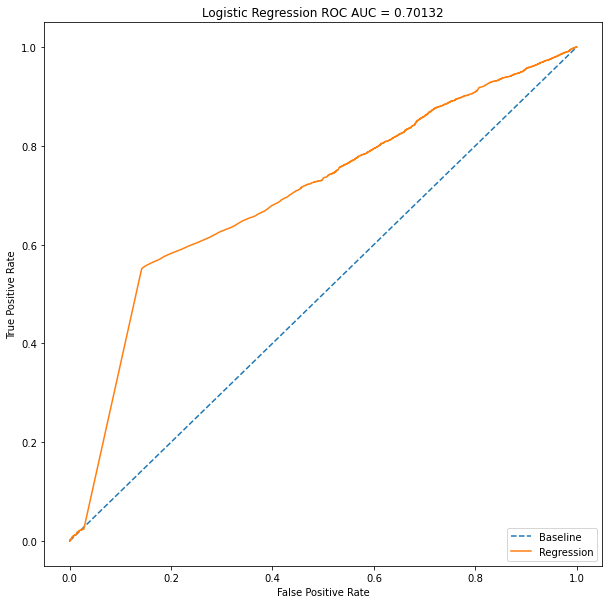

In [243]:
# модель после оптимизации
model = LogisticRegression(random_state=42, C=10, penalty='l2', class_weight={
                            1: 0.7, 0: 0.3}, solver='newton-cg', max_iter=1000)
model.fit(X_train, y_train)

y_pred_proba = model.predict_proba(X_valid)[:, 1]

y_pred = model.predict(X_valid)
fpr, tpr, threshold = roc_curve(y_valid, y_pred_proba)
roc_auc = roc_auc_score(y_valid, y_pred_proba)

plt.figure()
plt.plot([0, 1], label='Baseline', linestyle='--')
plt.plot(fpr, tpr, label='Regression')
plt.title('Logistic Regression ROC AUC = %0.5f' % roc_auc)
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc='lower right')
plt.show()

In [244]:
print('NAIVE Model\n')
print('accuracy_score:',accuracy_score(y_valid,y_pred))
print('precision_score:',precision_score(y_valid,y_pred))
print('recall_score:',recall_score(y_valid,y_pred))
print('f1_score:',f1_score(y_valid,y_pred))

NAIVE Model

accuracy_score: 0.7763721420570601
precision_score: 0.7928218501235246
recall_score: 0.9685613682092555
f1_score: 0.8719245283018868


[Text(0.5, 0, 'Predicted'), Text(0, 0.5, 'True')]

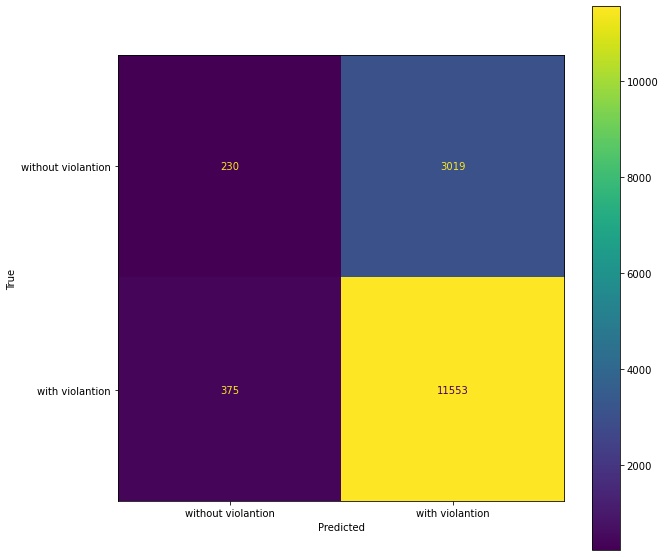

In [245]:
cm = confusion_matrix(y_valid, y_pred)
cmd = ConfusionMatrixDisplay(cm, display_labels=['without violantion','with violantion'])
cmd.plot()
cmd.ax_.set(xlabel='Predicted', ylabel='True')

In [198]:
hyperparameters = {'C': np.logspace(0, 4, 20)}

X = X_num
Y = df4[df4['sample'] == 1]['with_violantion'].values
X_test = X_num_test
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.20, random_state=42)


model = LogisticRegression(random_state=RANDOM_SEED,
                           class_weight='balanced', max_iter=1000)
# создадим сетку поиска с использованием 5-кратной перекрёстной проверки
clf = GridSearchCV(model, hyperparameters, cv=5, verbose=0, scoring='roc_auc')

best_model = clf.fit(X_train, y_train)

# вывод лучшего параметра С
print('Лучшее C:', best_model.best_estimator_.get_params()['C'])

Лучшее C: 1.0


In [199]:
# функци метрик ошибок
def scores(y_test, y_pred, prob):
    fpr, tpr, threshold = roc_curve(y_test, prob)
    roc_auc = roc_auc_score(y_test, prob)
    
    plt.figure()
    plt.plot([0, 1], label='Baseline', linestyle='--')
    plt.plot(fpr, tpr, label = 'Regression')
    plt.title('Logistic Regression ROC AUC = %0.3f' % roc_auc)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.legend(loc = 'lower right')
    plt.show()
    print ("f1_score:",round(f1_score(y_test,y_pred), 3))
    print ("accuracy_score:",round(accuracy_score(y_test,y_pred), 3))
    print ("precision_score:",round(precision_score(y_test,y_pred), 3))
    print ("recall_score:",round(recall_score(y_test,y_pred), 3))
    print ("roc_auc_score:",round(roc_auc, 3))
    print("average_precision_score:", round(average_precision_score(y_test,y_pred), 3))
    print("brier_score_loss:", round(brier_score_loss(y_test,y_pred), 3))
    print('Confusion matrix:\n{}' .format(confusion_matrix(y_test,y_pred)))

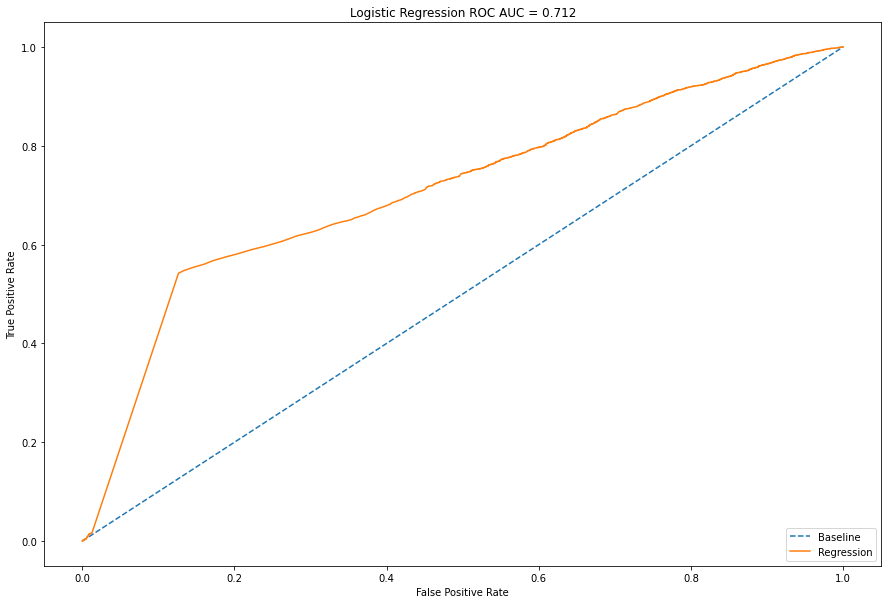

f1_score: 0.799
accuracy_score: 0.698
precision_score: 0.839
recall_score: 0.762
roc_auc_score: 0.712
average_precision_score: 0.826
brier_score_loss: 0.302
Confusion matrix:
[[1507 1742]
 [2839 9089]]


In [200]:
y_pred = best_model.predict(X_test)
proba = best_model.predict_proba(X_test)[:, 1]
scores(y_test, y_pred, proba)

[Text(0.5, 0, 'Predicted'), Text(0, 0.5, 'True')]

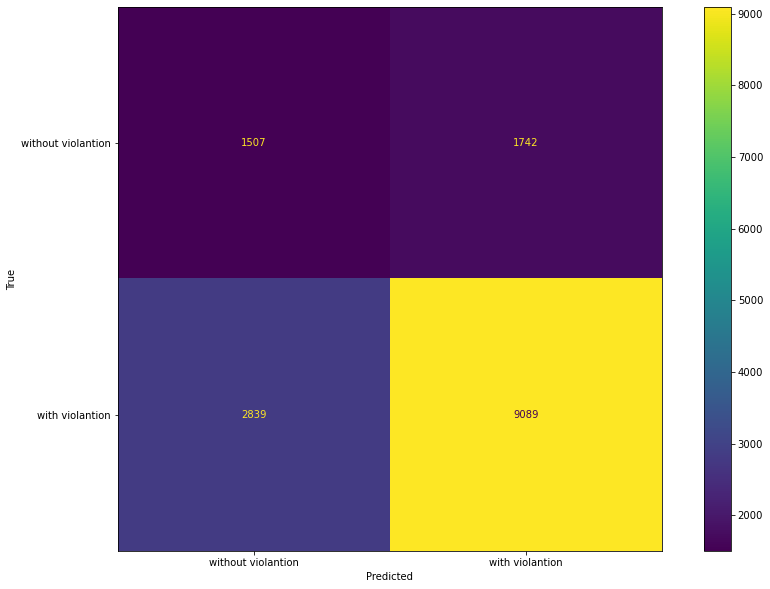

In [201]:
cm = confusion_matrix(y_test,y_pred)
cmd = ConfusionMatrixDisplay(cm, display_labels=['without violantion','with violantion'])
cmd.plot()
cmd.ax_.set(xlabel='Predicted', ylabel='True')

## Random forest

Перед тем как отправлять наши данные на обучение, разделим данные на еще один тест и трейн, для валидации. Это поможет нам проверить, как хорошо наша модель работает

In [208]:
train_data = df4.query('sample == 1').drop(['sample'], axis=1)
test_data = df4.query('sample == 0').drop(['sample'], axis=1)

y = train_data.with_violantion.values     # наш таргет
X = train_data.drop(['with_violantion', 'user_id', 'event_date'], axis=1)
X_sub = test_data.drop(['with_violantion'], axis=1)

In [209]:
# Воспользуемся специальной функцие train_test_split для разбивки тестовых данных
# выделим 20% данных на валидацию (параметр test_size)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=RANDOM_SEED)

In [210]:
# проверяем
test_data.shape, train_data.shape, X.shape, X_train.shape, X_test.shape

((233331, 17), (75885, 17), (75885, 14), (60708, 14), (15177, 14))

In [211]:
# Создаём модель 
model_rd = RandomForestRegressor(n_estimators=100, verbose=1, n_jobs=-1, random_state=RANDOM_SEED)

In [212]:
# Обучаем модель на тестовом наборе данных
model_rd.fit(X_train, y_train)

# Используем обученную модель для предсказания рейтинга ресторанов в тестовой выборке.
# Предсказанные значения записываем в переменную y_pred
y_pred = model_rd.predict(X_test)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    1.2s finished
[Parallel(n_jobs=12)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=12)]: Done  26 tasks      | elapsed:    0.0s
[Parallel(n_jobs=12)]: Done 100 out of 100 | elapsed:    0.0s finished


mean_absolute_error (средняя абсолютная ошибка), mean_squared_error (Среднеквадратическое отклонение), r2_score (коэффициент детерминации):

In [213]:
# Сравниваем предсказанные значения (y_pred) с реальными (y_test), и смотрим насколько они в среднем отличаются
# Метрика называется Mean Absolute Error (MAE) и показывает среднее отклонение предсказанных значений от фактических.
print ('MAE:', round (mean_absolute_error(y_test, y_pred),3))		#Метрики
print ('√MSE:', round (mean_squared_error(y_test, y_pred)**(1/2),3))
print ('R2_score:', round(r2_score(y_test, y_pred),3))

MAE: 0.284
√MSE: 0.392
R2_score: 0.086


<AxesSubplot:>

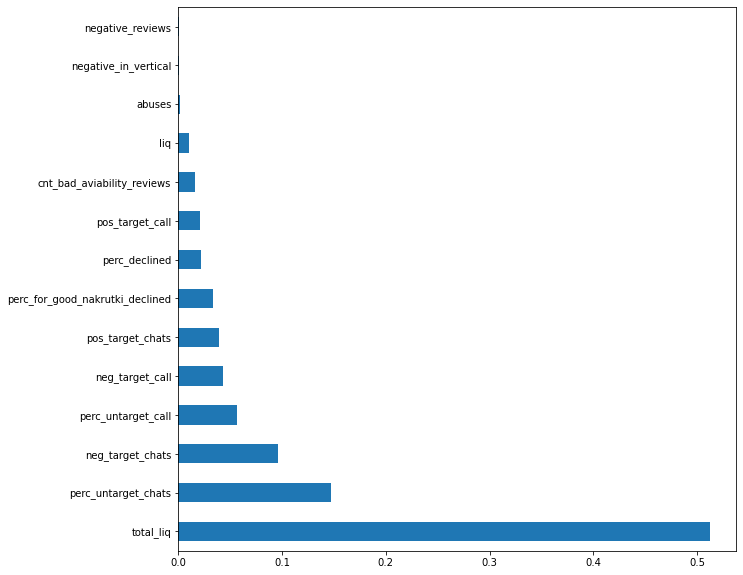

In [214]:
# в RandomForestRegressor есть возможность вывести самые важные признаки для модели
plt.rcParams['figure.figsize'] = (10,10)
feat_importances = pd.Series(model_rd.feature_importances_, index=X.columns)
feat_importances.nlargest(100).plot(kind='barh')


In [215]:
# Теперь выделим тестовую часть
train_data = df4.query('sample == 1').drop(['sample'], axis=1)
test_data = df4.query('sample == 0').drop(['sample'], axis=1)

y = train_data.with_violantion.values     # наш таргет
X = train_data.drop(['with_violantion', 'user_id', 'event_date'], axis=1)
X_sub = test_data.drop(['with_violantion'], axis=1)

In [216]:
# Воспользуемся специальной функцие train_test_split для разбивки тестовых данных
# выделим 20% данных на валидацию (параметр test_size)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=RANDOM_SEED)

In [226]:
TR = DecisionTreeRegressor(max_depth =8)#Создаем модель
TR.fit(X_train, y_train)#Обучаем модель
Y_TR=TR.predict(X_test) #Предсказываем значения для выборк

In [227]:
print ('MAE:', round (mean_absolute_error(y_test, Y_TR),3))		#Метрики
print ('√MSE:', round (mean_squared_error(y_test, Y_TR)**(1/2),3))
print ('R2_score:', round (r2_score(y_test, Y_TR),3))

MAE: 0.287
√MSE: 0.381
R2_score: 0.137


In [3]:
#Глубину дерева в параметрах модели ограничила, для того  чтобы найти оптимальную глубину просто сделала перебор 

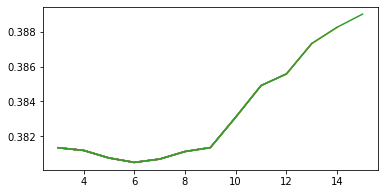

In [228]:
import matplotlib.pyplot as plt
dep,score=[],[]
for i in range(3,16):
    TR = DecisionTreeRegressor(max_depth=i)
    TR.fit(X_train, y_train)
    Y_TR=TR.predict(X_test)
    dep.append(i)
    score.append(mean_squared_error(y_test, Y_TR)**(1/2))	#Массив значений √MSE
    plt.rcParams['figure.figsize']=6,3
    plt.plot(dep, score)

In [229]:
X = train_data.drop(['with_violantion', 'user_id', 'event_date'], axis=1)

In [4]:
# И снова глянула наиболее важные фичи

<AxesSubplot:>

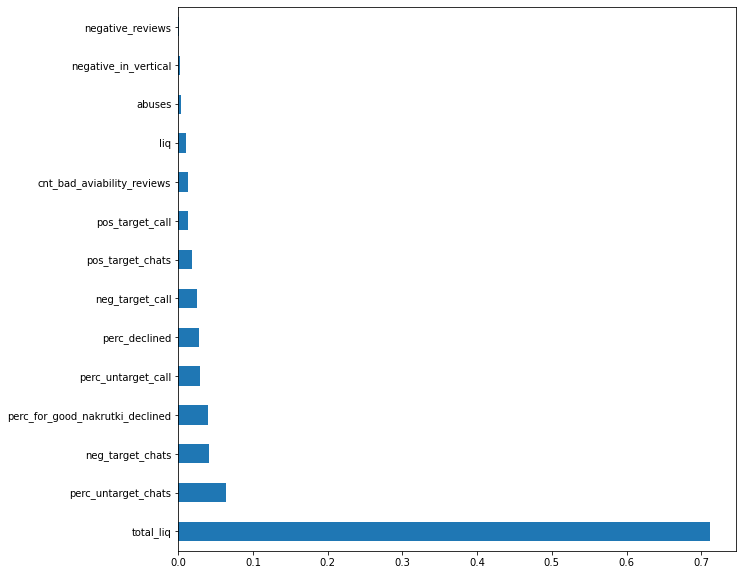

In [230]:
plt.rcParams['figure.figsize'] = (10,10)
feat_importances = pd.Series(TR.feature_importances_, index=X.columns)
feat_importances.nlargest(100).plot(kind='barh')

In [257]:
predict_data = model.predict(X_test)
predict_data

array([ True,  True,  True, ...,  True,  True,  True])

### Получилось, что леса и деревья чуть получше по MSE и  R2_score чем линейная регрессия, но не сильно. А линейную регрессию в нашем кейсе проще интерпретировать, поэтому остановимся на обычной линейной регрессии

**Модель показывает что юзеры с триггерами и нарушениями это юзеры у которых есть одной из условий** : 

- ликвидности собранной за последние 30 дней больше 0 и объявление актуально на момент скоринга
- процент нецелевых чатов более 0.8 и кол-во чатов более 7
- процент нецелевых звонков более 0.8 и кол-во чатов более 7
- процент накруток  к активным отзывам более 2
- процент отклоеннных через саппорт/арбитраж негативных отзывов к активным отзывам более 2
- более 50 негативных отзывов в вертикали за окно и/или более 50 негативных отзывов за окно в целом по всем вертикалям
- более 2х жалоб за окно

### Изменение метрики по цене нарушения c использованием приоритизации пользователей по триггерам с применением модели

Средняя стоимость проверки юзера → снижение на 10.5%
Стоимость нахождения пользователя с нарушением  → снижение на 5%